## 10. GAN

#### 1. Importing the libraries

In [3]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
import matplotlib.pyplot as plt
%matplotlib inline


#### 2. Load the dataset

In [5]:
cifar10 = tf.keras.datasets.cifar10

(train_x, _),(test_x, _) = cifar10.load_data()

train_x.shape

170508288/170498071 [==============================] - 3s 0us/step


(50000, 32, 32, 3)

- 학습에 사용할 train_x의 이미지를 -1, 1로 정규화

In [6]:
train_x = (train_x - 127.5) / 127.5

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


In [28]:
train_x = train_x.astype('float32')

- 로드한 학습 데이터 시각화

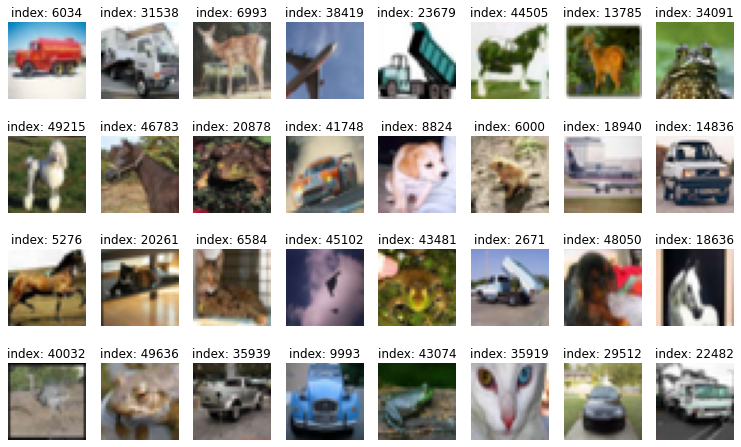

In [29]:
plt.figure(figsize=(13, 8))

for i in range(32):
    rn = np.random.randint(train_x.shape[0])
    plt.subplot(4, 8, i+1)
    Image = np.clip(train_x[rn], 0, 1)
    plt.imshow((train_x[rn] + 1)/2.0)
    plt.title(f'index: {rn}')
    plt.axis('off')
    
plt.show()

- tf.data.Dataset 모듈의 from_tensor_lices()함수를 사용하여 미니배치 데이터셋 구성

In [30]:
BUFFER_SIZE = 50000
BATCH_SIZE = 256

In [31]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

#### 3. Implementing a constructor model

- (32, 32, 3)의 shape를 가진 이미지를 생성하는 생성자 모델 구현 함수.

In [36]:
def make_generator_model():
    
    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, \
                                     activation='tanh'))

    return model

In [37]:
generator = make_generator_model()

generator.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 16384)             1638400   
_________________________________________________________________
batch_normalization_12 (Batc (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu_12 (LeakyReLU)   (None, 16384)             0         
_________________________________________________________________
reshape_4 (Reshape)          (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_12 (Conv2DT (None, 8, 8, 128)         819200    
_________________________________________________________________
batch_normalization_13 (Batc (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_13 (LeakyReLU)   (None, 8, 8, 128)        

- noise = tf.random.normal([1, 100])로 생성된 랜덤 노이즈를 입력으로 하여 구현한 생성자로 랜덤 이미지 생성.

In [43]:
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

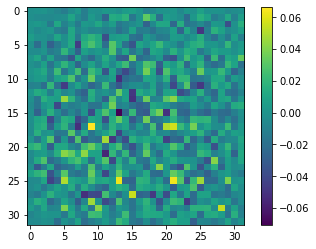

In [45]:
plt.imshow(generated_image[0, :, :, 0])
plt.colorbar()
plt.show()

#### 4. Implementing discriminant model

- (32, 32, 3)의 이미지를 입력으로 받아 1dim을 판별결과를 출력하는 판별자 모델 구현 함수 

In [46]:
def make_discriminator_model():
    
    # Start
    model = tf.keras.Sequential()
    
    # First : Conv2D layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Second Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Third : flatten layer
    model.add(layers.Flatten())
    
    # Fourth : Dense Layer
    model.add(layers.Dense(1))
    
    return model

In [47]:
discriminator = make_discriminator_model()

discriminator.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 16, 16, 64)        4864      
_________________________________________________________________
leaky_re_lu_15 (LeakyReLU)   (None, 16, 16, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 8, 8, 128)         204928    
_________________________________________________________________
leaky_re_lu_16 (LeakyReLU)   (None, 8, 8, 128)         0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 8, 8, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 8192)             

#### 5. Implementation of Loss Function and Optimization Function

- 생성자와 판별자의 loss 구현.

In [48]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [49]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [50]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

- 판별자의 출력값을 가지고 real/fake 이미지 판별 accuracy를 계산하는 함수 구현. 

In [51]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

- 생성자와 판별자를 최적화하는 optimizer 정의

In [52]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

#### 6. Implementation of Detailed Functions in Training Process

In [53]:
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

- 1개 미니배치의 훈련 과정을 처리하는 train_step() 함수 구현.

In [54]:
@tf.function
def train_step(images): # (1) 입력 데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim]) # (2) 생성자 입력 노이즈
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape: # (3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True) # (4) geerated_images 생성
        
        # (5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)
        
        # (6) loss 개선
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)
        
        # (7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output)
    
    # (8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    # (9) 모델 학습
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    return gen_loss, disc_loss, real_accuracy, fake_accuracy

- 16개의 고정된 seed를 입력으로 하여 훈련 과정 동안 생성한 이미지를 시각화하는 generate_and_save_images() 함수 구현

In [55]:
def generate_and_save_images(model, epoch, it, sample_seeds):
    
    predictions = model(sample_seeds, training=False)
    
    fig = plt.figure(figsize = (8, 8))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((predictions[i] + 1)/2.0)
        plt.axis('off')
    
    plt.savefig('{}/aiffel/exploration/miniproject/Ex10/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))
    plt.show()

- 훈련 epoch마다 생성자/판별자의 loss 및 판별자의 real/fake 이미지 판멸 accuracy history를 그래프로 시각화하는 draw_train_history() 함수 구현

In [71]:
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/exploration/miniproject/Ex10/training_history/first_train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

- training_checkpoints 디렉토리에 n epoch마다 모델을 저장하는 checkpoint 모듈 설정

In [72]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/fashion/first_training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

#### 7. Learning process progress

- 최소 50epoch 만큼의 모델 학습 진행

In [58]:
save_every = 5
EPOCHS = 50

In [105]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

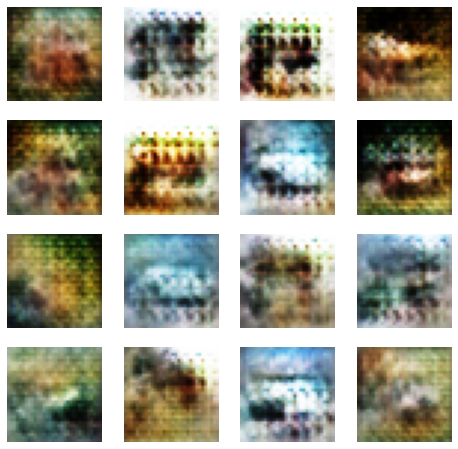

Time for training : 823 sec


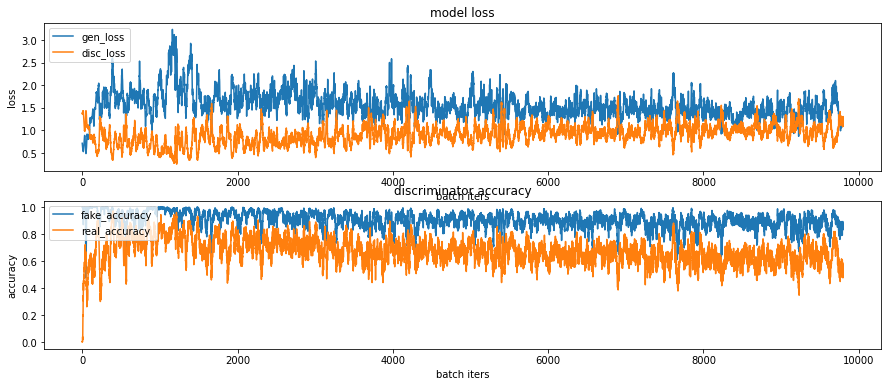

CPU times: user 14min 15s, sys: 1min 4s, total: 15min 20s
Wall time: 13min 44s


In [60]:
%%time
train(train_dataset, EPOCHS, save_every)

- 학습 과정에서 생성된 샘플 이미지로 만든 gif파일을 통해 학습 진행 과정 시각적 표현

In [61]:
anim_file = os.getenv('HOME')+'/aiffel/exploration/miniproject/Ex10/fashion_mnist_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/exploration/miniproject/Ex10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/exploration/miniproject/Ex10/fashion_mnist_dcgan.gif

-rw-r--r-- 1 root root 3218363 Feb 15 07:34 /aiffel/aiffel/exploration/miniproject/Ex10/fashion_mnist_dcgan.gif


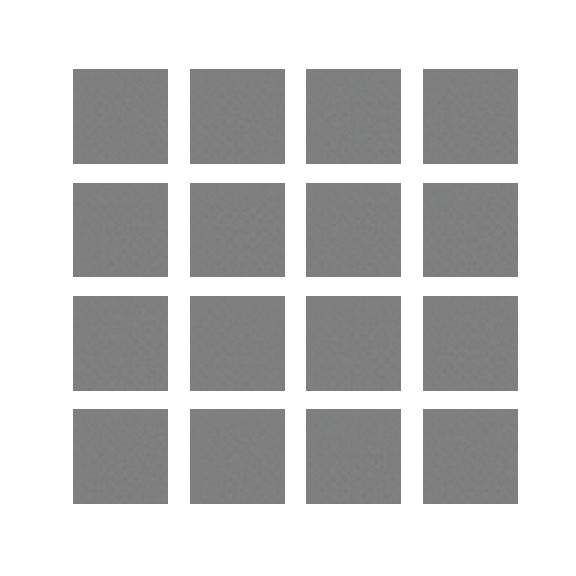

In [62]:
from IPython.display import Image

Image(os.getenv('HOME')+'/aiffel/exploration/miniproject/Ex10/fashion_mnist_dcgan.gif')

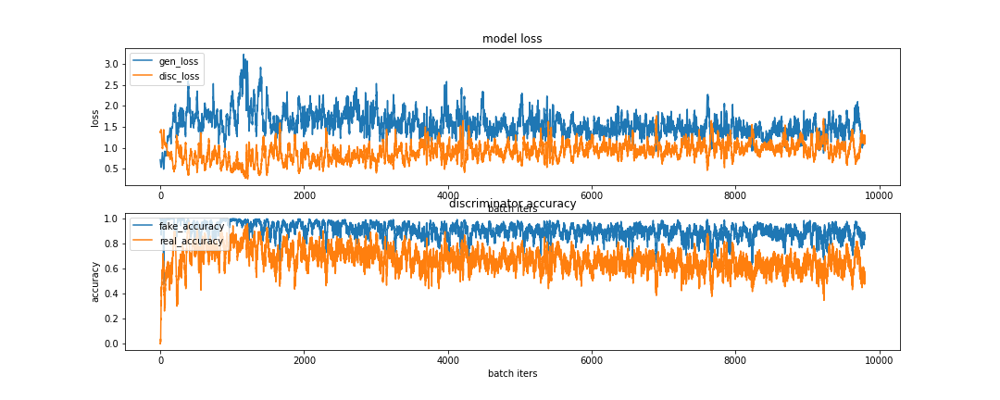

In [65]:
display.Image(os.getenv('HOME')+'/aiffel/exploration/miniproject/Ex10/training_history/train_history_0049.png')

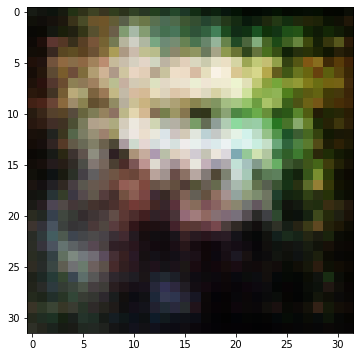

In [67]:
checkpoint_dir = os.getenv('HOME')+'/aiffel/exploration/miniproject/Ex10/training_checkpoints'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

# 로드한 모델이 정상적으로 이미지를 생성하는지 확인해 봅니다. 
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  # 정상적으로 모델이 로드되었다면 랜덤 이미지가 아니라 CIFAR-10 이미지가 그려질 것입니다.

#### 8. Model improvment

**1. epochs 조정**

In [103]:
save_every = 5
EPOCHS = 10

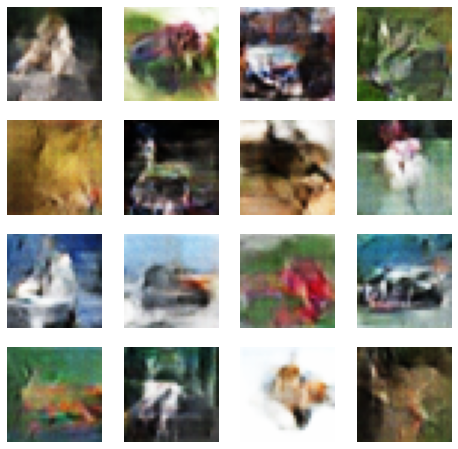

Time for training : 20265 sec


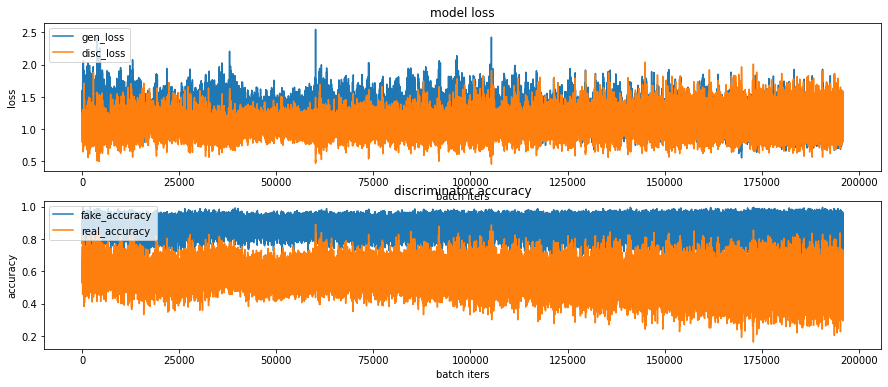

CPU times: user 5h 46min 48s, sys: 23min 23s, total: 6h 10min 11s
Wall time: 5h 37min 56s


In [73]:
%%time
train(train_dataset, EPOCHS, save_every)

In [74]:
anim_file = os.getenv('HOME')+'/aiffel/exploration/miniproject/Ex10/cifar10_dcgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('{}/aiffel/exploration/miniproject/Ex10/generated_samples/sample*.png'.format(os.getenv('HOME')))
    filenames = sorted(filenames)
    last = -1
    for i, filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

!ls -l ~/aiffel/exploration/miniproject/Ex10/cifar10_dcgan.gif

-rw-r--r-- 1 root root 11826031 Feb 15 13:35 /aiffel/aiffel/exploration/miniproject/Ex10/cifar10_dcgan.gif


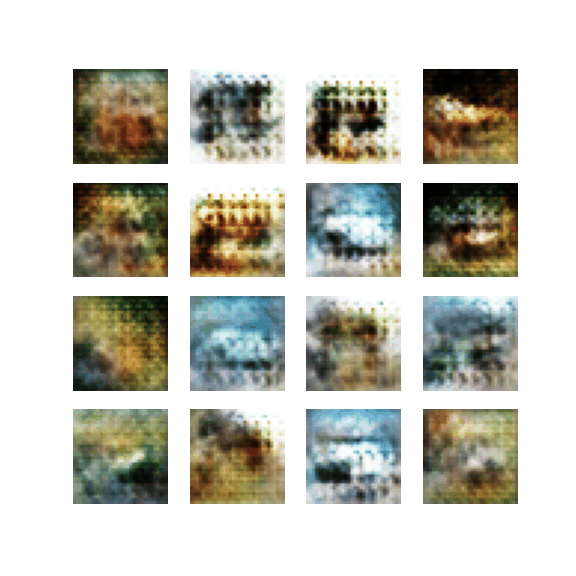

In [77]:
Image(os.getenv('HOME')+'/aiffel/exploration/miniproject/Ex10/cifar10_dcgan.gif')

: 무작정 단순하게 에포크만 늘리는 것은 한계가 존재하는 것 같다. 학습 시간이 오래걸려 회고를 급히 마치고 제출하지만 추후에 생성자, 판멸자 모델의 레이어에 변화를 줘 다시 한번 확인해야 할 것 같다.

In [98]:
tf.test.gpu_device_name()

'/device:GPU:0'

In [99]:
tf.test.is_gpu_available()

True

In [100]:
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [101]:
from tensorflow.python.client import device_lib

print(device_lib.list_local_devices())


[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 14590427217447584576
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 11407196160
locality {
  bus_id: 1
  links {
  }
}
incarnation: 3157873641034919129
physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
]


In [102]:
import numpy as np

import pandas as pd



import keras

import tensorflow as tf

from IPython.display import display

import PIL


In [104]:
%%time
train(train_dataset, EPOCHS, save_every)

AttributeError: 'function' object has no attribute 'clear_output'

In [93]:
import os

os.environ["CUDA_VISIBLE_DEVICES"]="0"
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError as e:
        print(e)

Physical devices cannot be modified after being initialized
